KUL H02A5a Computer Vision: Group Assignment 2
---------------------------------------------------------------
Student numbers: <span style="color:red">r0974957, r0975376, r0674083, r0687031, r0811736</span>.


In [31]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [32]:
!ls "/content/drive/MyDrive/cv/group_assignment"

content  dataset.zip  fcn_models  fcn_models_1	final_check


In [33]:
!ls "/content"

drive  sample_data  test  train


In [34]:
!unzip "/content/drive/MyDrive/cv/group_assignment/dataset.zip"

Archive:  /content/drive/MyDrive/cv/group_assignment/dataset.zip
replace test/test_set.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: a
error:  invalid response [a]
replace test/test_set.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: test/test_set.csv       
  inflating: test/img/._test_406.npy  
  inflating: test/img/._test_716.npy  
  inflating: test/img/._test_520.npy  
  inflating: test/img/._test_204.npy  
  inflating: test/img/._test_612.npy  
  inflating: test/img/test_681.npy   
  inflating: test/img/._test_274.npy  
  inflating: test/img/._test_24.npy  
  inflating: test/img/test_343.npy   
  inflating: test/img/test_385.npy   
  inflating: test/img/._test_334.npy  
  inflating: test/img/._test_202.npy  
  inflating: test/img/test_111.npy   
  inflating: test/img/._test_44.npy  
  inflating: test/img/._test_170.npy  
  inflating: test/img/._test_206.npy  
  inflating: test/img/._test_18.npy  
  inflating: test/img/._test_75.npy  
  inflating: test/img/._test_666.npy  
 

# 1. Overview <a id='overview'></a>
Brief (interactive) overview of the notebook:

* [1 Overview](#overview)
    * [1.1 Environment setup & Deep learning resources](#deep-learning-resources)
    * [1.2 Dataset setup](#dataset-setup)
    * [1.3 Kaggle submission](#kaggle-submission)
* [2 Image classification](#image-classification)
    * [2.1 Image pre-processing](#image-pre-processing)
    * [2.2 Model training/validation](#vgg16)

* [3 Semantic segmentation](#3-semantic-segmentation)
    * [3.1 Custom model testing](#model-testing)
    * [3.2 Model exploration](#model-exploration)

* [4 Adversarial attack](#4-adversarial-attack)
    * [4.1 ResNet Inverse training](#41-resnet-inverse-training)
    * [4.2 The encoder network](#42-the-encoder-network)
    * [4.3 Fooling the model](#43-fooling-the-model)
    * [4.4 Adversarial attack conclusion](#44-adversarial-attack-conclusion)

Brief summary of the assignment:   

In the first part, you train an end-to-end neural network for image classification. In the second part, you will do the same for semantic segmentation. For these two tasks we expect you to put a significant effort into optimizing performance and as such competing with fellow students via the Kaggle competition. In the third part, you will try to find and exploit the weaknesses of your classification and/or segmentation network. For the latter there is no competition format, but we do expect you to put significant effort in achieving good performance on the self-posed goal for that part. Finally, we ask you to reflect and produce an overall discussion with links to the lectures and "real world" computer vision (Sect. 5). It is important to note that only a small part of the grade will reflect the actual performance of your networks. However, we do expect all things to work! In general, we will evaluate the correctness of your approach and your understanding of what you have done that you demonstrate in the descriptions and discussions in the final notebook.

## 1.1 Environment setup & Deep learning resources <a id='deep-learning-resources'></a>
For our project, we have made extensive use of both the Keras, Tensorflow and PyTorch frameworks. In addition, we used some extra libraries to calculate losses and automate generating some of our other training/validation metrics. Because the models, compared to last project, were much more computationally expensive, we have also experimented with GPU and cloud acceleration in Cuda.

Before jumping into all of that, we prepare our Kaggle environment.

In [35]:
# from google.colab import drive
# drive.mount('/content/drive/')

In [36]:
path_to_ext_dataset = "/content/drive/MyDrive/cv/group_assignment/content/dataset_upload/"         # In Kaggle we can add a dataset to the kernel, so we can use this path to access the dataset
path_to_train = "/content/train/"                     # -> We can have our csv files there, as well as the images and weights
path_to_test = "/content/test/"    # Set both train and test paths to the last "test" or "train" folder in the path

In [37]:
# General Python3 Docker environment: https://github.com/kaggle/docker-python
import numpy as np
import pandas as pd
import tensorflow as tf
from matplotlib import pyplot as plt
import torch
import cv2 as cv

import os
from keras.models import Model
from keras.optimizers import Adam
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.applications.resnet50 import ResNet50
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.layers import Dense, Dropout, Flatten
from pathlib import Path
from sklearn.model_selection import train_test_split
import seaborn as sns

## 1.2 Dataset setup <a id='dataset-setup'></a>
For this project we used the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. The dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes.

*The functions from this section were all provided in the notebook template.*

The training set contains 749 examples.


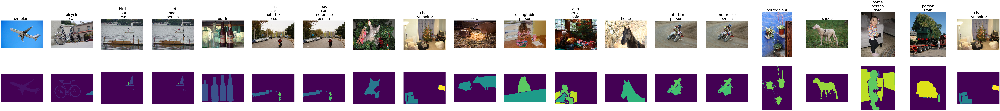

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,"[[[10, 8, 13], [16, 14, 19], [17, 14, 21], [19...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [38]:
# Loading the training data
train_df = pd.read_csv(path_to_train + 'train_set.csv', index_col="Id")
labels = train_df.columns
train_df["img"] = [np.load(path_to_train + 'img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load(path_to_train + 'seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
print("The training set contains {} examples.".format(len(train_df)))

# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")

plt.show()

# The training dataframe contains for each image 20 columns with the ground truth classification labels and 20 column with the ground truth segmentation maps for each class
train_df.head(1)

In [39]:
# Loading the test data
test_df = pd.read_csv(path_to_test + 'test_set.csv', index_col="Id")
test_df["img"] = [np.load(path_to_test + 'img/test_{}.npy'.format(idx)) for idx, _ in test_df.iterrows()]
test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in test_df["img"]]
print("The test set contains {} examples.".format(len(test_df)))

test_df_submission = test_df.copy()   # make a copy where we will never directly edit the images. This way we don't double pre-process them by accident later on

# The test dataframe is similar to the training dataframe, but here the values are -1 --> our task is to fill in these as good as possible in Sect. 2 and Sect. 3; in Sect. 6 this dataframe is automatically transformed in the submission CSV!
test_df.head(1)

The test set contains 750 examples.


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


## 1.3 Kaggle submission <a id='kaggle-submission'></a>
*Likewise, this code was provided in the template. It is called later on in our notebook to create the final submission file.*

In [40]:
def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array

    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.

    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted

    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))

    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

# 2. Image classification <a id='image-classification'></a>

In [41]:
trainX = train_df["img"].to_numpy()
trainY = train_df[labels].to_numpy()
print(f"trainX shape: {trainX.shape}")

testX = test_df["img"].to_numpy()
print(f"testX shape: {testX.shape}")

trainX shape: (749,)
testX shape: (750,)


To work with the provided images, we will first apply rescaling and interpolation. This allows us to use batches of same-sized tensors as inputs to our model during validation and training.

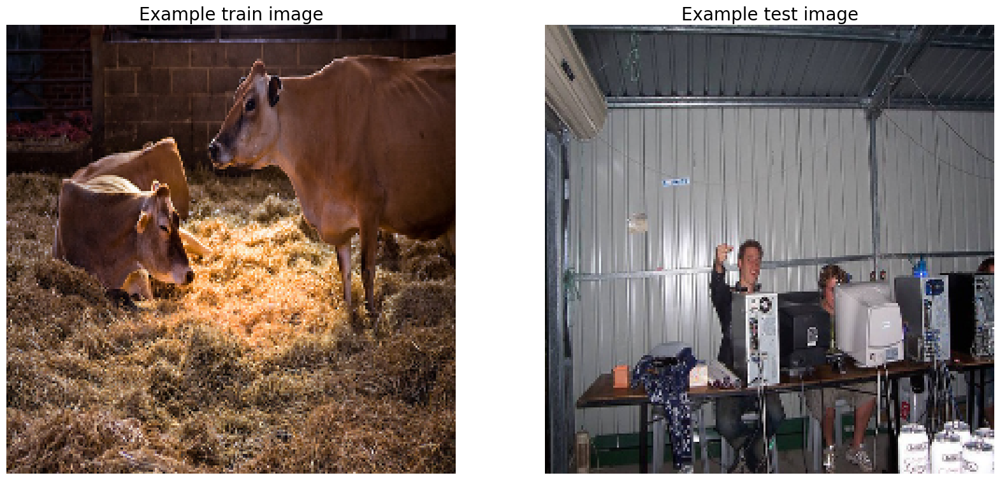

In [42]:
images = [cv.resize(image, (224,224), interpolation = cv.INTER_LINEAR) for image in trainX]                     # train images
images_test = [cv.resize(image_test, (224,224), interpolation = cv.INTER_LINEAR) for image_test in testX]       # test images

fig, axs = plt.subplots(1, 2, figsize=(10 * 2, 10))
axs[0].imshow(images[0], vmin=0, vmax=255)
axs[0].set_title("Example train image", fontsize=20)
axs[0].axis("off")
axs[1].imshow(images_test[0], vmin=0, vmax=255)
axs[1].set_title("Example test image", fontsize=20)
axs[1].axis("off")
plt.show()

These images already look good! Their aspect ratio is slightly distorted, but the reshape is necessary for some of the models we have investigated. We can keep the stretching/squeezing in mind when making conclusions later on.

In [43]:
from keras.preprocessing.image import img_to_array

# convert the image pixels to a numpy array
images = [img_to_array(image) for image in images]
images_test = [img_to_array(image_test) for image_test in images_test]

images = [image.reshape((image.shape[0], image.shape[1], image.shape[2])) for image in images]
images_test = [image_test.reshape((image_test.shape[0], image_test.shape[1], image_test.shape[2])) for image_test in images_test]

The models we will investigate for this section were trained on the ImageNet dataset, which contained circa 10000 classes.

The first of such model is **VGG16**. On initial inspection we noticed that we **needed additional pre-processing** to make our model fit the data. For instance, without this additional step, if presented with a image of a horse, the model classified it as a great dane (black dog breed).

To enhance our dataset, we apply zero-centering to our data with the preprocess_input function used below.

In [44]:
from keras.applications.vgg16 import preprocess_input

# prepare the image for the VGG model
images = np.array([preprocess_input(image) for image in images])
images_test = np.array([preprocess_input(image_test) for image_test in images_test])

We now have to further investigate the distribution of classes in our dataset. Is it imbalanced?

trainX shape: (749, 224, 224, 3), trainY shape: (749, 20)


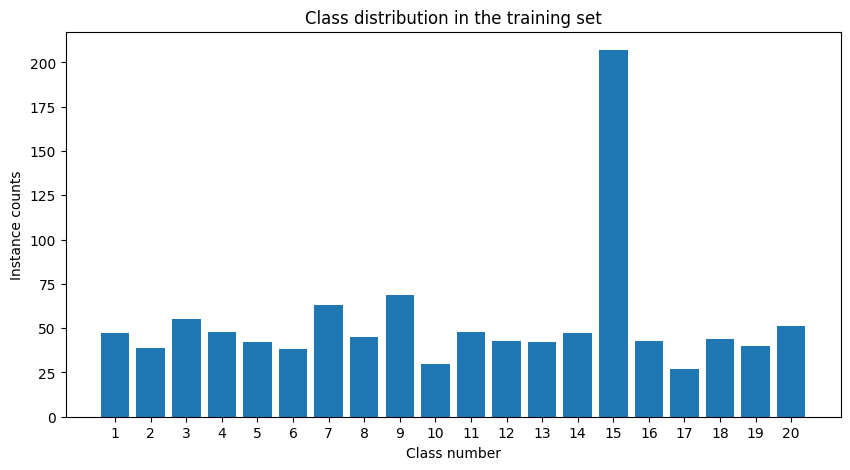

In [45]:
trainX = images.copy()
trainY = train_df[labels].to_numpy()

testX = images_test.copy()

print(f"trainX shape: {trainX.shape}, trainY shape: {trainY.shape}")

plt.figure(figsize=(10, 5))
plt.bar(np.arange(1,21,1),np.sum(trainY,axis=0))
plt.xlabel("Class number")
plt.ylabel("Instance counts")
plt.title("Class distribution in the training set")
plt.xticks(np.arange(1,21,1))
plt.show()

Oh oh... Class number 15, this being "person", has many more samples that all others. Not to mention that all others have less than 100 samples, which is bad, even for transfer learning. To counter that, we will augment the other classes and increase their size. To augment the images, we constructed an augmentation network in Tensorflow consisting of geometric transofrmations: flipping, rotation, zoom and translation. In the beggining we also included intensity augmenting layers to this network, like random contrast and brightness shifts. However, we found that the network works better without them, as the zero-centering for ResNet already creates very drastic changes to image intensities. Also, this zero centering is done by subtracting the mean values of the ImageNet dataset, which are close to our values. But, by adding random brightness and contrast correction, we introduce error which can corrupt the entire training process. Therefore, we settle for the outlined architecture.

One thing that is not decided upon is how much will the data be augmented. For each class, we will add enough data so that each class has at least as many samples as class number 15 ("person") has in the original dataset, which is $\approx$ 200 samples. To get there, we divide the of "person" labels in the original dataset with a number of samples in other classes to get the number of augmentations per class. We then augment each class, except the most numerous one.

After augmentation, we will randomly split the data into training and validation set in the ratio 90-10 %. This way, we can keep track of the training progress. We split the data randomly because the image dataset is big enough after augmentation so that other, more sofisticated methods like k-fold crossvalidation, are harder to justify. Couple of thousand images all together should suffice for our purposes.

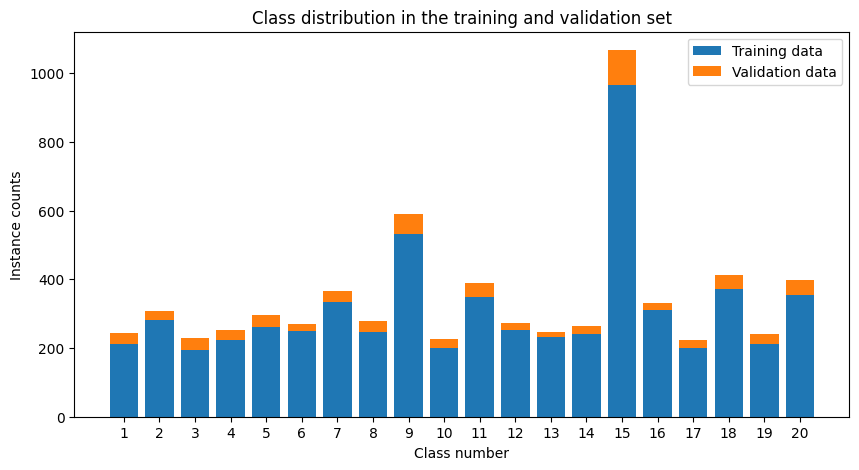

In [46]:
# General data augmentation

tf.random.set_seed(42)

data_aug = tf.keras.Sequential([
  tf.keras.layers.RandomFlip("horizontal"),
  tf.keras.layers.RandomRotation(0.1),
  tf.keras.layers.RandomZoom(.1),
  tf.keras.layers.RandomTranslation(.1,.1),
])

counts=max(np.sum(trainY,axis=0))//np.sum(trainY,axis=0)

finalX=trainX.copy()
finalY=trainY.copy()
for i in range(len(counts)):
    indices=np.where(np.array([1 if lbl[i] else 0 for lbl in trainY])==1)[0]
    if i!=14:
      for j in range(counts[i]):
        finalX=np.concatenate((finalX,data_aug(trainX[indices])))
        finalY=np.concatenate((finalY,trainY[indices]))

trainX,valX,trainY,valY=train_test_split(finalX,finalY,test_size=.1,random_state=42)

plt.figure(figsize=(10, 5))
plt.bar(np.arange(1,21,1),np.sum(trainY,axis=0),label="Training data")
plt.bar(np.arange(1,21,1),np.sum(valY,axis=0),bottom=np.sum(trainY,axis=0),label="Validation data")
plt.legend()
plt.xlabel("Class number")
plt.ylabel("Instance counts")
plt.title("Class distribution in the training and validation set")
plt.xticks(np.arange(1,21,1))
plt.show()

Quite unexpectedly, the number of "persons" in our dataset grew to over 1000. This means that there is a lot of overlap between that class and others when it comes to image presence. This leaves our dataset still imbalanced. We could search for images with only one label and augment those, but certain classes have very few examples of those. We will have to address this issue in some other way. Worry not, this will be taken care of! After executing the above cell, we have 3837 training samples and 437 validation samples.

## 2.2 Model training/validation <a id='vgg16'></a>

Now that we have our training/validation/testing data all set up, we can start our training.

We will start with the aforementioned **VGG16 model**. On top of that, we create a dense neural network after its convolutional layers.

The model was compiled with Adam optimizer and $\eta=0.001$. Sigmoid activations were placed at the outputs to allow for independant probability estimates. By default, VGG has softmax activations, and is hence used for single-label classifications. This is not the case here, as one image can have multiple labels. However, those images are in a minority (585 out of 3113 training images).

Before training, we have to choose the loss function. As we are predicting probabilities of an image belonging to some class, all our outputs are in the range $[0,1]$, and are independent from each other. Go-to loss for this scenario would be the binary crossentropy. However, recall that our dataset is very imbalanced. Because of this, we achieve better results when using the focal loss function, which modulates the crossentropy loss with $(1-p_i)^\gamma$, for some value of modulating factor $\gamma$. This makes the model focus more on the "hard" examples which the model predicts wrongly. More details can be found [via link](https://arxiv.org/pdf/1708.02002). The default value of $\gamma$ is 2, and it will be used in this notebook. Also, we will implement the Dice score as a metric to keep track of our training progress.

In [47]:
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.layers import Dense, Dropout, Flatten

tf.random.set_seed(42)      # For reproducibility

base_model = VGG16()
for layer in base_model.layers[:-1]:
    layer.trainable = False

# Add dense layers at the end of the base model
x = Dense(1024, activation='relu')(base_model.output)
x = Dense(1024, activation='relu')(x)
x = Dense(512, activation='relu')(x)
x = Dense(64, activation="relu")(x)

predictions = Dense(20, activation='sigmoid')(x)

model = Model(inputs=base_model.input, outputs=predictions)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=.001),
    loss='categorical_focal_crossentropy', metrics=[tf.keras.metrics.F1Score()])
model.summary()     # Get overview of the model

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

The model has circa 6.7 milion parameters, just for future model reference. Batchsize was chosen to be 128, as lower values of 64, e.g., produce very noisy gradients. Larger batch values are computationaly more heavy and do not contribute to loss improvement.

The optimized loss function is the so called focal loss, or categorical focal crossentropy. It is related to categorical crossentropy, but it is more adapted to imbalanced datasets, like ours. When we tried to optimize the standard crossentropy, it got stuck relatively quickly.

As a performance indicator, we use the F1-score. It is a harmonic mean of precision and recall. It provides a more balanced assessment of a classifier dealing with imbalanced data. A perfect classifier has the F1-score of 1.

Without further adue, we set the training to commence!

In [48]:
%timeit
# Reference time: 10min with L4 TPU, 62.8GB RAM

# # Training
# history=model.fit(trainX, trainY.astype("float32"), batch_size=128, epochs=15,
#           validation_data=(valX,valY.astype("float32")))

# model.save_weights('/content/drive/MyDrive/cv/group_assignment/content/dataset_upload/vgg16_weights.h5')

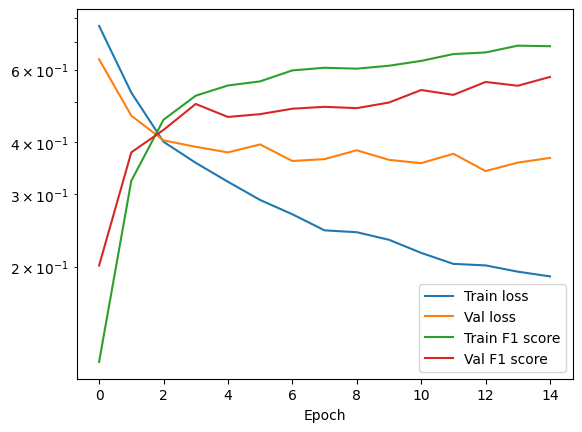

We also trained a classification model with a ResNet backbone. Like we did with VGG, weights (except for the last couple of layers) were frozen and only the dense network was trained. This model outperformed the VGG, after architecture redesign. This time, we took fewer neurons per each layer. We also implemented a new metric to keep track of model's performance, this being the Dice Score.

In [49]:
from tensorflow.keras import backend as K
from tensorflow import keras

@keras.saving.register_keras_serializable()   # Helps us load models with references to these custom functions
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection) / (K.sum(y_true_f) + K.sum(y_pred_f))

@keras.saving.register_keras_serializable()   # ^^^^
def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

In [50]:
tf.random.set_seed(42)

base_model = ResNet50()
for layer in base_model.layers[:-5]:
    layer.trainable = False

x = Dense(1000, activation='relu')(base_model.output)
x = Dense(500, activation='relu')(x)
x = Dense(100, activation='relu')(x)
x = Dense(50, activation="relu")(x)

predictions = Dense(20, activation='sigmoid')(x)

model = Model(inputs=base_model.input, outputs=predictions)
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=.0001),
    loss='binary_focal_crossentropy', metrics=[dice_coef])
model.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_5[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [51]:
# history1=model.fit(trainX, trainY.astype("float32"), batch_size=128, epochs=35,
#           validation_data=(valX,valY.astype("float32")))

In [52]:
# model.save_weights(path_to_ext_dataset + "resnet_weights_class.h5")

We see that we have less trainable weights than we did before. This is more than welcome, especially because they are pretrained on the same dataset as VGG (this being ImageNet). We settled for a smaller step size $\eta=0.0001$, as the gradients became less noisy and training becomes more stable in later epochs.

We always save/load our model weights to avoid re-running the training often. For this notebook, we will simply load the weights from a previous run.

Several edits to the added dense layers' layout while observing runs, in addition to tuning general parameters such as epoch, batch size, etc.
In the end, there were two models that stuck out for us, one Resnet implementation, the other VGG16. Below, you can see the training history of the ResNet architecture.

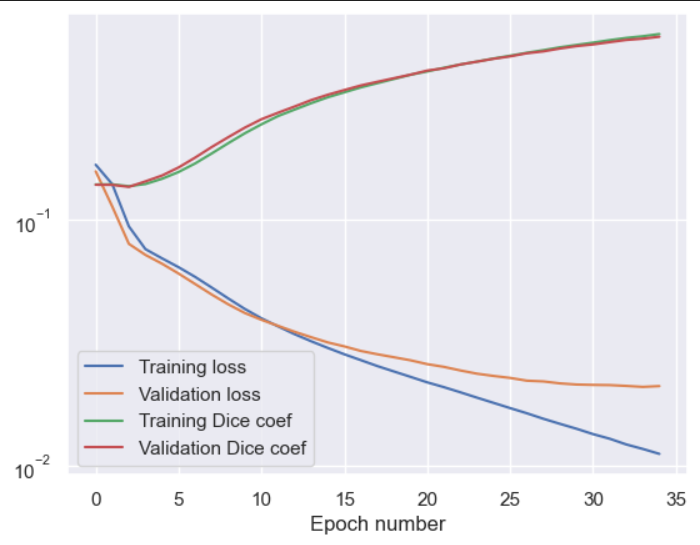

In [53]:
from tensorflow import keras

model=Model(inputs=base_model.input, outputs=predictions)
model.load_weights(path_to_ext_dataset + "resnet_weights_class.h5")

Finally, we predict the outputs. Images were assigned to certain classes if the sigmoid output of a particular neuron was above the chosen threshold value $\eta$. In the case of VGG, we settled for very high threshold value of $\eta=0.99$. However, upon using this with ResNet, we discovered that the model did not have many false positive results, but far more false negative results. This meant that our model dissmised true underlying classes. To counter this, we lower the threshold to $\eta=0.6$. This resulted in immediate result improvement.

In [54]:
yhat=model.predict(testX)

24/24 [==============================] - 2s 40ms/step


In [55]:
yhat1 = yhat.copy()
thresh=.6
yhat1=yhat1>thresh
yhat1=yhat1.astype("uint8")

for i in range(len(yhat1)):
    if np.sum(yhat1[i])==0:
        yhat1[i] = (yhat[i]>=max(yhat[i])).astype("uint8")

Now that we have the predicted values we can generate the first part of our submission file.

In [56]:
cols = test_df_submission.columns.values[:-2]
test_df_submission[cols] = yhat1

For the purpose of being complete, we also trained a CNN classification model from scratch. It began with a rescaling layer where zero-centered images were brought down to a smaller range, like $[-\frac{1}{2},\frac{1}{2}]$. This is not an exact range because our preprocessed images are zero-centered w.r.t. the ImageNet dataset, but it is close to that.

Moving on, we have three blocks consisting of two convolutional layers followed by a maximum pooling layer. Each convolutional layer has the kernel size of (5,5) and ReLU activation. One additional convolution is added after that, resulting in 256 channels. A dense network is attached at the end, consisting of 4 layers with 2048, 1024, 256 and 20 neurons. At the end, we have cca 8 million trainable parameters, even more than we had with VGG. The optimizer is Adam with a stepsize of 0.00001.

In [57]:
tf.random.set_seed(42)
custom_model=tf.keras.Sequential([
    tf.keras.layers.Rescaling(1./255,input_shape=(224,224,3)),

    tf.keras.layers.Conv2D(4,(5,5),activation="relu"),
    tf.keras.layers.Conv2D(4,(5,5),activation="relu"),
    tf.keras.layers.MaxPool2D((2,2)),

    tf.keras.layers.Conv2D(16,(5,5),activation="relu"),
    tf.keras.layers.Conv2D(16,(5,5),activation="relu"),
    tf.keras.layers.MaxPool2D((2,2)),

    tf.keras.layers.Conv2D(64,(5,5),activation="relu"),
    tf.keras.layers.Conv2D(64,(5,5),activation="relu"),
    tf.keras.layers.MaxPool2D((2,2)),

    tf.keras.layers.Conv2D(256,(5,5),activation="relu"),
    tf.keras.layers.Conv2D(256,(5,5),activation="relu"),
    tf.keras.layers.MaxPool2D((2,2)),

    tf.keras.layers.Conv2D(256,(5,5),activation="relu"),



    tf.keras.layers.Flatten(),
    # tf.keras.layers.Dense(256,activation="relu"),
    # #tf.keras.layers.Dense(1024,activation="relu"),
    # #tf.keras.layers.Dense(1024,activation="relu"),
    tf.keras.layers.Dense(2048,activation="relu"),
    tf.keras.layers.Dense(1024,activation="relu"),
    tf.keras.layers.Dense(256,activation="relu"),
    tf.keras.layers.Dense(20,activation="sigmoid")
])

custom_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=.00001),
    loss='categorical_focal_crossentropy', metrics=[dice_coef])
custom_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 220, 220, 4)       304       
                                                                 
 conv2d_1 (Conv2D)           (None, 216, 216, 4)       404       
                                                                 
 max_pooling2d (MaxPooling2  (None, 108, 108, 4)       0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 104, 104, 16)      1616      
                                                                 
 conv2d_3 (Conv2D)           (None, 100, 100, 16)      6416      
                                                      

As expected, the custom model did not surpass the pretrained architectures in terms of accuracy. Several changes were attempted to help it, like another optimizer (we experimented with SGD, as we are dealing with a fairly complex, non-convex function), lowering the learning rate, additional data augmentation... However, we think that the limiting factor which is very hard to overcome in this case is the limited dataset we are working with. Not only that, but it is also very imbalanced, as indicated before.

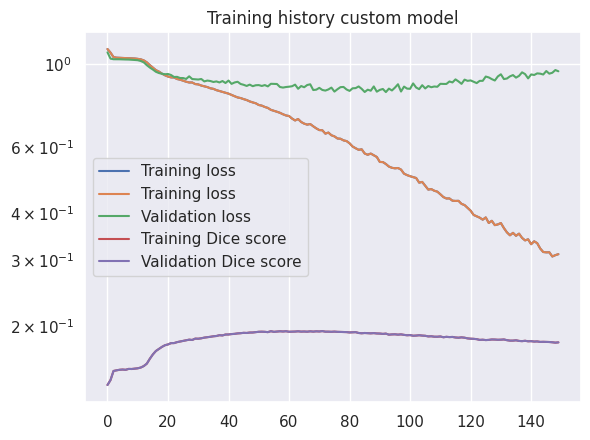

In [58]:
# history1=custom_model.fit(trainX, trainY.astype("float32"), batch_size=128, epochs=150,
#           validation_data=(valX,valY.astype("float32")))

In [59]:
# General history plotting method applied over our notebook

# sns.set()
# plt.title("Training history custom model")
# plt.plot(history1.history["loss"],label="Training loss")
# plt.semilogy(history1.history["loss"],label="Training loss")
# plt.semilogy(history1.history["val_loss"],label="Validation loss")
# plt.semilogy(history1.history["dice_coef"],label="Training Dice score")
# plt.semilogy(history1.history["dice_coef"],label="Validation Dice score")
# plt.legend()

# 3. Semantic segmentation

**Brief assignment:**
Our goal here is to implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (and/or background). We use the training set to train our CNN and compete on the test set (by filling in the segmentation column in the test dataframe).

As the above text hints, we are no now looking at each individual pixel's class. This also means that we now consider object area for our class distribution.

We can, for example, imagine that background might take up the largest number of pixels in our image. We can plot the pixel-per-class histogram to see if that is indeed the case.

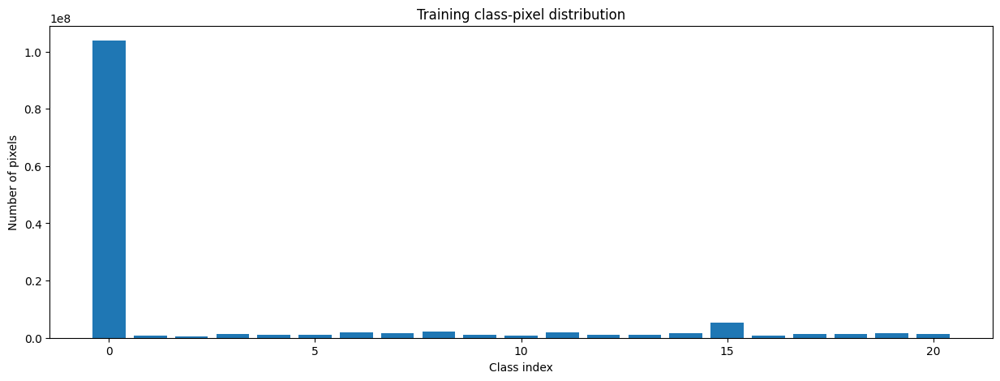

In [60]:
class_distribution = np.zeros(len(labels) + 1)      # We consider both labels + a background class

# We iterate the provided training segmentation masks
# -> How many pixels belong to each class?
for _, row in train_df.iterrows():
    for i, label in enumerate(labels):
        class_distribution[i+1] += np.sum(row["seg"] == i+1)
    class_distribution[0] += np.sum(row["seg"] == 0)

plt.figure(figsize=(15, 5))
plt.bar(range(len(labels) + 1), class_distribution)
plt.ylabel("Number of pixels")
plt.xlabel("Class index")                                                   # Class 0 = background, remaining are in order of the labels
plt.title("Training class-pixel distribution")
plt.show()

As we expected, the background takes up the overwhelming majority of pixels. This makes the dataset very inbalanced, something we have to take into account during our training later on. With an inproper loss, the model would be content simply guessing 'background' for each pixel.

We can create a second histogram without the background class, to inspect the distribution inbetween labels better.

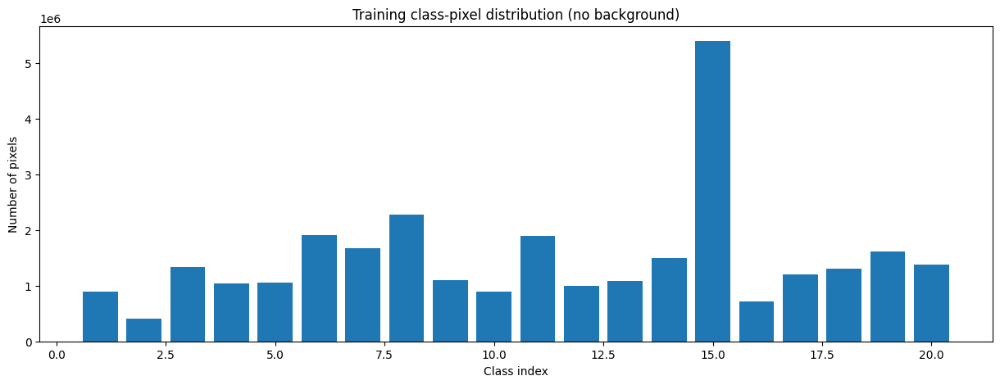

In [61]:
plt.figure(figsize=(15, 5))
plt.bar(range(1, len(labels) + 1), class_distribution[1:])
plt.ylabel("Number of pixels")
plt.xlabel("Class index")
plt.title("Training class-pixel distribution (no background)")
plt.show()

Only looking at PASCAL VOC labels, the training dataset is already much more balanced. We still have one class that sticks out, at index 15.

In [62]:
print(f"The label that still sticks out is: --{labels[14]}--")   # Label at index 15

The label that still sticks out is: --person--


The person class being abundantly present is also to our expectation. During the image classification phase of this project, we also noticed that many images included people, sometimes even multiple on a single image.

To take into account the imbalance of classes later on, we already create an inverse class distribution list. We will use this list later on to scale the importance of each class to calculate our loss.
- Class occurs more often -> smaller importance on loss

In [63]:
import torch

total_pixels = np.sum(class_distribution)
inverse_class_distribution = total_pixels / class_distribution
inverse_class_distribution = torch.Tensor(inverse_class_distribution)
print("inverse class distribution:\n")
print(f"background: \t{inverse_class_distribution[0]}")
for i, label in enumerate(labels):
    print(f"{label}:    \t{inverse_class_distribution[i+1]}")

inverse class distribution:

background: 	1.2863093614578247
aeroplane:    	148.7906951904297
bicycle:    	326.9617004394531
bird:    	99.54417419433594
boat:    	128.58807373046875
bottle:    	125.89960479736328
bus:    	69.63709259033203
car:    	79.53430938720703
cat:    	58.56298828125
chair:    	120.98200988769531
cow:    	150.28570556640625
diningtable:    	70.34373474121094
dog:    	134.26487731933594
horse:    	123.59981536865234
motorbike:    	88.94674682617188
person:    	24.722274780273438
pottedplant:    	185.61520385742188
sheep:    	111.3616943359375
sofa:    	101.6708755493164
train:    	82.56217956542969
tvmonitor:    	96.64530181884766


We can split our set into training and validation. We opted for a 8-2 ratio.

In [64]:
# Splitting the training data into a training and a validation set
from sklearn.model_selection import train_test_split

random_seed = 10    # reproducibility
val_split = 0.2
train_df_s, val_df_s = train_test_split(train_df, test_size=val_split, random_state=random_seed)

print(f"Split into {len(train_df_s)} training and {len(val_df_s)} validation examples.")

Split into 599 training and 150 validation examples.


We now create our training and validation set, as well as their respective dataloaders.

----

We need two different transforms for the image and the segmentation. Both need to be converted to tensors, but we will also normalize the images. This normalization is done based on very common values for the Imagenet dataset. We decided these normalization values would also apply to our dataset, as Imagenet is representative of a large number of common images.

Something very different from our image classification section is the the final output result needs to be the same shape as our initial input image.

First, we made several attempts using a custom **collate** function, in which we append all images in a batch to a list instead of stacking them. This allows us to train the model without reshaping the image at all, but makes this process much more difficult. Pytorch provides a lot of flexibility, hence why we chose to do our initial approach and investigation in this framework instead of the simplified Keras.
- We ended up deciding to go for a resize -> model -> reshape approach in the end. The complexity that the custom collate function added to our training was not worth the slight decreas in information loss from not scaling.

We select the batch size of 16 images. Most of the training was done on our personal devices using GPUs (Cuda implementation), so such a large batch size coupled with a rather large input tensor size was quite heavy on our hardware, but ended up being a good (working) choice at the end of our implementation.

In [65]:
# We will have to reverse the reshape operation and want to lose as little info as possible. Therefore we will select the best resize shape based on the shapes of the training images.
shapes = np.array([img.shape for img in train_df["seg"]])
# Get the average shape
avg_shape = np.mean(shapes, axis=0)
print(f"The average shape of the training segmentation masks is: {avg_shape}")
# We will resize to 416x416, a common size for segmentation tasks and one fitting the average shape
# It is essential to

The average shape of the training segmentation masks is: [383.05607477 471.84379172]


In [66]:
# transform the images and segmentation maps to torch tensors
import torch
from torchvision import transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.nn.functional import one_hot

class CustomDataset(Dataset):
    def __init__(self, df, transform_img, transform_seg):
        self.df = df
        self.transform_img = transform_img      # transform for the images
        self.transform_seg = transform_seg      # transform for the segmentation maps

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img = self.transform_img(self.df.iloc[idx]["img"])
        seg = self.transform_seg(self.df.iloc[idx]["seg"])

        # one-hot encoding for the segmentation map makes it easier for us later on
        seg = one_hot(seg.to(torch.int64), num_classes=len(labels) + 1).squeeze(0).permute(2, 0, 1).float()

        return img, seg

transform_img = transforms.Compose([
    transforms.ToPILImage(),                                                                # Convert to PIL image
    transforms.Resize((416, 416), interpolation=transforms.InterpolationMode.BILINEAR),     # Bilinear interpolation for high quality
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),            # Imagenet normalization values
])

transform_seg = transforms.Compose([
    transforms.ToPILImage(),                                                                # Convert to PIL image
    transforms.Resize((416, 416), interpolation=transforms.InterpolationMode.NEAREST),      # Only nearest neighbour (segmentation map should not be interpolated)
    # transforms.ToTensor()                 # DO NOT USE ToTensor(), as it will convert the segmentation map to [0, 1] range
    transforms.Lambda(lambda x: torch.Tensor(np.array(x)))
])

# Custom collate
# # # # # # # # # #
def collate_fn(batch):                      # Can be used if we don't want to rescale our images, then tensors can't be stacked
    data = [item[0] for item in batch]
    target = [item[1] for item in batch]
    return [data, target]                   # Returned as a datatype we know [ data, target ]
# # # # # # # # # #                         # -> if used, should be taken into account in the model (no single batch)

train_dataset = CustomDataset(train_df_s, transform_img, transform_seg)
val_dataset = CustomDataset(val_df_s, transform_img, transform_seg)
test_dataset = CustomDataset(test_df, transform_img, transform_seg)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)#, collate_fn=collate_fn)        # Selected batch size of 16
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)#, collate_fn=collate_fn)           # We don't shuffle the validation or test set
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)#, collate_fn=collate_fn)         #

print(f"The training dataset contains {len(train_dataset)} examples")
print(f"The validation dataset contains {len(val_dataset)} examples")
print(f"The test dataset contains {len(test_dataset)} examples")

The training dataset contains 599 examples
The validation dataset contains 150 examples
The test dataset contains 750 examples


To evaluate our model, we decide on the scores to use.
For our segmentation section, we will will use:
- Dice score
- Mean IoU

These are two commonly used scores in image segmentation. They both express a measure of overlap between the predicted and training segmentation map. In addition, dice score is used for the Kaggle competition for this project.

In [67]:
!pip install segmentation_models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.9 MB/s eta 0:00:00


In [68]:
# # # # # # Workaround problem importing segmentation_models
%env SM_FRAMEWORK=tf.keras
# # # # # #

from tensorflow import keras
import segmentation_models as sm
                                                # Two main scores:
IoU_score = sm.metrics.IOUScore(threshold=0.5)  # - IoU                         Both functions provide default smooth of 1e-05, to avoid division by zero
dice_score = sm.metrics.FScore(threshold=0.5)   # - Dice

env: SM_FRAMEWORK=tf.keras
Segmentation Models: using `tf.keras` framework.


The metrics above are used during training in the keras framework. To manually use them on individual images, we need to define them ourselves. We specifically selected the Pytorch framework for our initial exploration because it provides an incredible flexibility albeit with additional complexity as a result.

In [69]:
def custom_IoU_score(y_true, y_pred, smooth=1e-5, threshold=0.8):

    y_pred_binary = np.where(y_pred > threshold, 1, 0)      # Binarize the predictions using threshold

    # # Binarize the predictions using argmax
    # y_pred_binary = np.zeros_like(y_pred)
    # y_pred_binary[np.arange(y_pred.shape[0])[:, None], np.argmax(y_pred, axis=1).flatten()] = 1


    iou_per_class = []

    for i in range(y_true.shape[1]):                                                            # Iterate over class channels

        y_true_flatten, y_pred_flatten = y_true[:, i].flatten(), y_pred_binary[:, i].flatten()        # Flatten for easier calculations

        # Simple IoU formula
        intersection = np.sum(y_true_flatten * y_pred_flatten)
        union = np.sum(y_true_flatten) + np.sum(y_pred_flatten) - intersection

        iou = (intersection + smooth) / (union + smooth)    # I smoothed the values to avoid division by zero
        iou_per_class.append(iou)

    return np.mean(iou_per_class)

def custom_dice_score(y_true, y_pred, smooth=1e-5, threshold=0.8):

    y_pred_binary = np.where(y_pred > threshold, 1, 0)

    # y_pred_binary = np.zeros_like(y_pred)
    # y_pred_binary[np.arange(y_pred.shape[0]), np.argmax(y_pred, axis=1)] = 1

    dice_per_class = []

    for i in range(y_true.shape[0]):

        y_true_flatten, y_pred_flatten = y_true[:, i].flatten(), y_pred_binary[:, i].flatten()

        # Similar approach to the IoU score, slightly different formula
        intersection = np.sum(y_true_flatten * y_pred_flatten)
        dice = (2 * intersection + smooth) / (np.sum(y_true_flatten) + np.sum(y_pred_flatten) + smooth)

        dice_per_class.append(dice)

    return np.mean(dice_per_class)

In [70]:
# Create dummy data y_true and y_pred
y_true = np.ones((16, 21, 416, 416))
y_pred_rand = np.random.rand(16, 21, 416, 416)
y_pred_one = np.ones((16, 21, 416, 416))


# Calculate the custom IoU and Dice scores
print(f"Custom IoU score for random predictions: {custom_IoU_score(y_true, y_pred_rand)}")
print(f"Custom Dice score for random predictions: {custom_dice_score(y_true, y_pred_rand)}")
print(f"Custom IoU score for ones predictions: {custom_IoU_score(y_true, y_pred_one)}")
print(f"Custom Dice score for ones predictions: {custom_dice_score(y_true, y_pred_one)}")

Custom IoU score for random predictions: 0.19991761887990592
Custom Dice score for random predictions: 0.33321238992527386
Custom IoU score for ones predictions: 1.0
Custom Dice score for ones predictions: 1.0


As we exprect, both the IoU and Dice score give a perfect 1.0 when the prediction is perfect. The other values for random data is also as expected. We are using a threshold of 0.8, which means the majority of predictions will be incorrect. It seems the IoU is slightly stricter on these mistakes, which makes sense because dice score will mainly penalise for false overlaps, which is less likely in our case with random data.

We want to have a way to check if our model is taking the inbalance in the distribution into account. It would be easy to simply guess "background" for each pixel and get a semi-decent result, but this is not what we want from a good segmentation mask. Hence, we check what scores a "background only" model would get, to compare to our final model.

In [71]:
import torch.nn as nn
import torch

class BackgroundModel(nn.Module):
    def __init__(self):
        super(BackgroundModel, self).__init__()

    def forward(self, x):
        tremp_background_tensor = torch.zeros(x.shape[0], 21, x.shape[2], x.shape[3])           # Create tensor of zeros with shape (batch, 1, height, width)
        tremp_background_tensor[:, 0] = 1                                                       # Set the class channel (background) to 1 (will be the highest value)
        return tremp_background_tensor

background_model = BackgroundModel()
background_model(torch.zeros(16, 3, 416, 416)).shape    # Quick test

torch.Size([16, 21, 416, 416])

In [72]:
# calulate the IoU and Dice score for the background model
mean_IoU = 0
mean_dice = 0

for (data_batch, target_batch) in val_loader:
    output = background_model(data_batch)

    mean_IoU += custom_IoU_score(target_batch.numpy(), output.detach().numpy())
    mean_dice += custom_dice_score(target_batch.numpy(), output.detach().numpy())

mean_IoU /= len(val_loader)
mean_dice /= len(val_loader)

print(f"The mean IoU score for the background model is {mean_IoU}")
print(f"The mean Dice score for the background model is {mean_dice}")

The mean IoU score for the background model is 0.41350498474200686
The mean Dice score for the background model is 0.42443672696834306


As we can see, just guessing background provides a decent result. For our final model, we wish to beat this by a significant margin.

Now that we have defined our scores and a baseline value for them, we can define define the loss we will use to train our models. For this, we opted for focal loss, a variant of cross-entropy loss, which better takes into account the inbalance of our dataset in addition to brining a greater focus to badly-classified images.

We defined the function for this ourselves. This provides us the most flexibility. Additionally, this ensures that our loss functions within the Pytorch frameweork. Pytorch computes backpropagenation based on graph traversal, and defining the loss ourselves ensures that the loss is never decoupled from it's graph history.

In [73]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class FocalLoss(nn.Module):
    def __init__(self, gamma=2, alpha=None):       # default gamma == 2 recommended by focal loss paper authors
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        self.alpha = alpha

    def forward(self, input, target):
        target = target.long().argmax(dim=1)
        cross_loss = F.cross_entropy(input, target)      # we start with standard cross-entropy loss

        pt = torch.exp(-cross_loss)
        focal_loss = -(1 - pt) ** self.gamma * torch.log(pt + 1e-5)         # Added small 1e-5 bias to avoid log(0)
        # As we can see for the formula, pt < 0.5 will increase the loss, pt > 0.5 will decrease the loss. Gamma will increase the difference between the two
        # This produces the desired effect of focusing on hard examples

        if self.alpha is not None:
            alpha_factor = self.alpha[target]
            focal_loss = focal_loss * alpha_factor

        return focal_loss.mean()     # Chose to do a mean instead of sum reduction, this prevents the loss from being too high

We will pass the inverse class distribution we created earlier as the alpha for our focal loss. This will allow us to take into account the inbalance during training.

In [74]:
focal_loss = FocalLoss(gamma=2, alpha=inverse_class_distribution)
focal_loss_no_alpha = FocalLoss()

We can quickly demonstrate the influence of the alpha on the loss calculation. As we expect, the "only background" model has a much greater loss once we take into account the distribution.

In [75]:
iterer_train = iter(train_loader)
temp_data, temp_seg = next(iterer_train)

temp_output = background_model(temp_data)

temp_loss_no_alpha = focal_loss_no_alpha(temp_output, temp_seg)
temp_loss = focal_loss(temp_output, temp_seg)
print(f"The focal loss without alpha is {temp_loss_no_alpha}")
print(f"The focal loss with alpha is {temp_loss}")

The focal loss without alpha is 1.9819064140319824
The focal loss with alpha is 48.555416107177734


Now it is time to define our model. Because of our success using resnet for the image classification section of the project, we first explored two models that use this modes as a backbone.

The model in question:
- FCN-ResNet
- DeepLabV3-ResNet

In our first exploration, we initialized only the backbone weights (ResNet trained on ImageNetV1). This means that all other weights are randomly initialized.

We also tried without the backbone ImageNet weights, but never were able to get significant results. **Our training resources are too limited to start all the way from scratch with such deep models.**

In [76]:
from torchvision.models.segmentation import fcn_resnet101

from torchvision.models import ResNet101_Weights

res_weights = ResNet101_Weights.IMAGENET1K_V1
model_fcn = fcn_resnet101(weights=None, progress=False, num_classes=len(labels)+1, weights_backbone=res_weights)    # No weights except backbone

print(model_fcn)

Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth
100%|██████████| 171M/171M [00:01<00:00, 119MB/s]


FCN(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequenti

Initially, we edited the model output dimension to fit our 21 classes. After discovering the num_classes parameter in our model initialisation, we no longer need to worry about doing this manually.

In [77]:
# model_fcn.classifier[4] = nn.Conv2d(512, len(labels)+1, kernel_size=(1, 1), stride=(1, 1))      # manual last layer edit to output size
# nn.init.xavier_uniform_(model_fcn.classifier[4].weight)                                         # manual last layer parameter initialization
# print(model_fcn)

Using Cuda on our local machine allows for faster processing times. This is essential with large models such as the ones we are working with.

In [78]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device {device}")

torch.cuda.empty_cache()    # Empty the cache to avoid memory errors (re-start after crash)

scaler = torch.cuda.amp.GradScaler()

# device = "cpu"      # default, no difficulties with memory

Using device cuda


In [79]:
inverse_class_distribution = inverse_class_distribution.to(device)
focal_loss = FocalLoss(gamma=2, alpha=inverse_class_distribution)

Our training loop takes into account all the design decisions we have made thusfar, for example, our choice to take a large batch size of 16.

To enable our training on devices with limited hardware resources, we added the option to specify light_mode=True and train with a basic form of mixed-precision training to limit Cuda memory usage. We tried using it a few times, but ended up computing most of the segmentation models on Cloud.

## 3.2 Segmentation model training/validating

In [80]:
import torch

def train(model, train_loader, criterion, optimizer, device, light_mode: bool = False):
    model.train()
    running_loss = 0.0

    for i, (img_batch, seg_batch) in enumerate(train_loader):

        optimizer.zero_grad()
        loss_batch = 0.0

        img_batch, seg_batch = img_batch.to(device), seg_batch.to(device)   # Move data to cuda or cpu

        if (light_mode):
            with torch.cuda.amp.autocast():                     # Mixed precision auto-cast for model forward pass and loss calculation
                output = model(img_batch)["out"]
                loss_batch = criterion(output, seg_batch)

            scaler.scale(loss_batch).backward()                 # Mixed precision backpropagation
            scaler.step(optimizer)                              # Mixed precision optimizer step
            scaler.update()

            del loss_batch, img_batch, seg_batch, output
            torch.cuda.empty_cache()

        else:
            output = model(img_batch)["out"]
            loss_batch = criterion(output, seg_batch)

            loss_batch.backward()                               # Standard backpropagation
            optimizer.step()

        running_loss += loss_batch.item()
        print(f"\rBatch {i}/{len(train_loader)}, Loss: {loss_batch}", end="")

    return running_loss / len(train_loader)

Our basic validation loop computes the loss for validation, as well as our two custom scores we defined earlier.

In [81]:
def validate(model, val_loader, criterion, device):
    model.eval()

    loss_val = 0.0
    mean_IoU_val = 0.0
    mean_dice_val = 0.0

    with torch.no_grad():
        for img_batch, seg_batch in val_loader:

            img_batch, seg_batch = img_batch.to(device), seg_batch.to(device)
            output = model(img_batch)["out"].detach()

            loss_val += criterion(output, seg_batch)

            output = output.cpu().numpy()
            seg_batch = seg_batch.cpu().numpy()

            mean_IoU_val += custom_IoU_score(seg_batch, output)
            mean_dice_val += custom_dice_score(seg_batch, output)

    loss_val /= len(val_dataset)
    mean_IoU_val /= len(val_dataset)
    mean_dice_val /= len(val_dataset)

    return loss_val, mean_IoU_val, mean_dice_val

We take a very common apprach to our optimizer, opting for Adam with a learning rate of 0.001

In [82]:
optimizer = torch.optim.Adam(model_fcn.parameters(), lr=0.001)
model_fcn = model_fcn.to(device)

Then it is time for us to train our models!

We logged all metrics in csv files during training. In addition, the model weights were saved every 4 epochs, which allowed us to pick our best epochs after training (especially useful in case we see overfitting after some time).

In [83]:
# # Create a new file in fcn_models/ to save the epoch loss
# file = open("fcn_models/training_data.csv", "w")

In [84]:
%timeit
# These models take an enormous amount of time to run!

# nr_epochs = 100
# for epoch in range(nr_epochs):

#     # # # # # # # Training
#     model_fcn.train()
#     loss_train = train(model_fcn, train_loader, focal_loss, optimizer, device)

#     # # # # # # # Validation
#     model_fcn.eval()
#     loss_val, mean_IoU_val, mean_dice_val = validate(model_fcn, val_loader, focal_loss, device)

#     print(f"\nEpoch {epoch}/{nr_epochs}, Loss train: {loss_train}, Loss val: {loss_val}, IoU val: {mean_IoU_val}, Dice val: {mean_dice_val}")
#     file.write(f"{epoch},{loss_train},{loss_val},{mean_IoU_val},{mean_dice_val}\n")

#     # save the temp model every 4 epochs
#     if epoch % 4 == 0:
#         torch.save(model_fcn.state_dict(), f"fcn_models/model_epoch_{epoch}.pt")

In [85]:
# # close the file
# file.close()

We can take a closer look at the training and validation loss after +- 60 epochs of training the fcn resnet model.

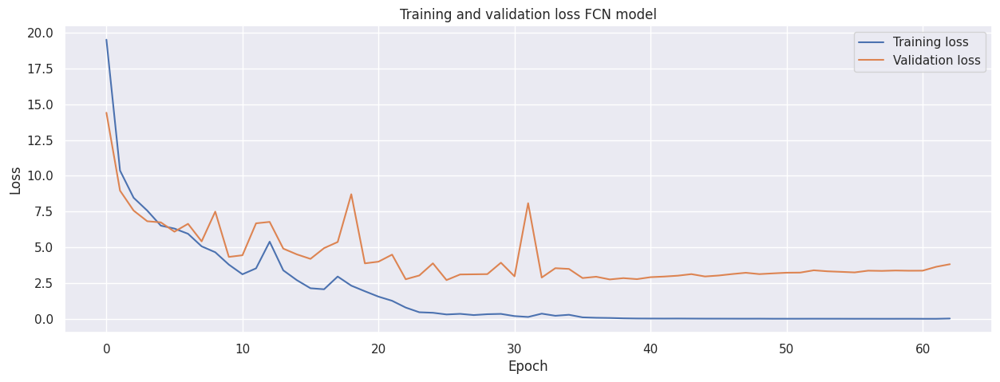

We can nicely see that the validation loss follows the training loss the first 10 epochs or so. Afterwards, the model starts having trouble improving the validation loss, while still actively improving the training loss.

After about 25 epochs, we don't see a significant change any longer in both the validation and training loss.

We have also done the same training on the second model, DeeplabV3, with the same backbone to compare the two.

In [86]:
from torchvision.models.segmentation import deeplabv3_resnet101
from torchvision.models import ResNet101_Weights

res_weights = ResNet101_Weights.IMAGENET1K_V1
model_deep = deeplabv3_resnet101(weights=None, progress=False, num_classes=len(labels)+1, weights_backbone=res_weights)

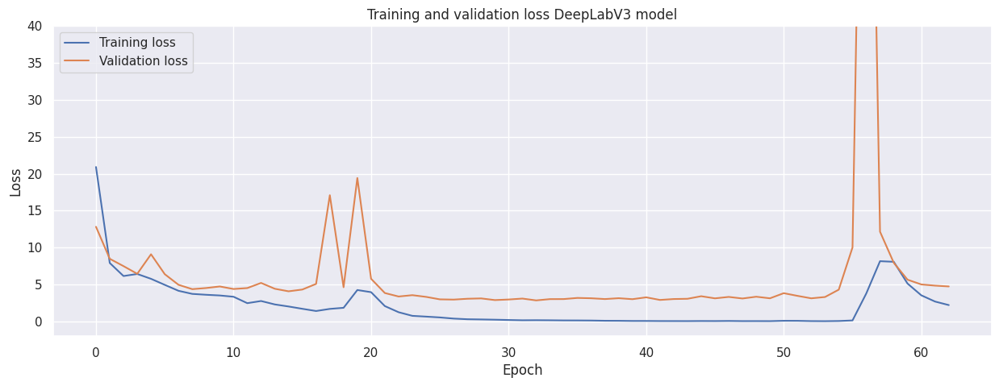

We can see that the second model starts off slightly better (potentially simple chance of initialization), but performs slightly worse in the long run. Both, however, idle out completely by around 30 epochs without further significant improvement.  

Does this mean that the model doesn't change any more and keeps predicting the same type of things? For that we will also look at our validation IoU and Dice scores.

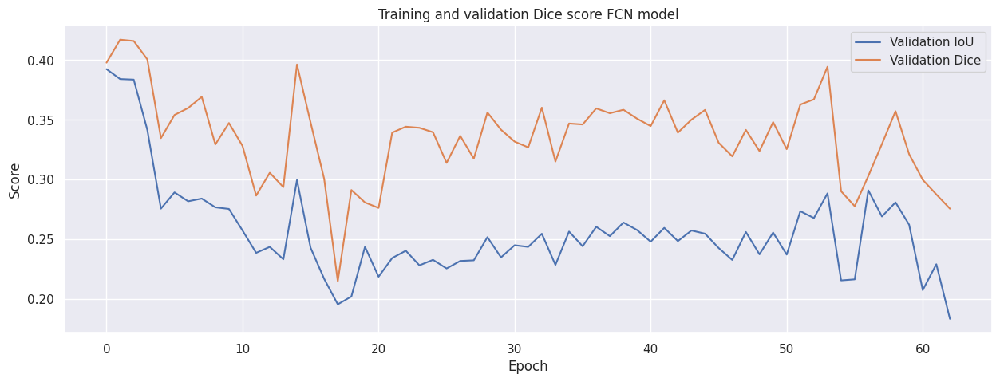

Contrary to what we expected, our dice and IoU scored do not increase greatly in line with the decrease in our losses.

This is, however, to be taken with a grain of salt. Out loss function is computed using an argmax operator, meaning it takes into account the single most likely class, no matter how high its output value. This is not how we defined our scores. As our focal loss introduces uncertainty, some may not breach our 0.8 threshold any longer.

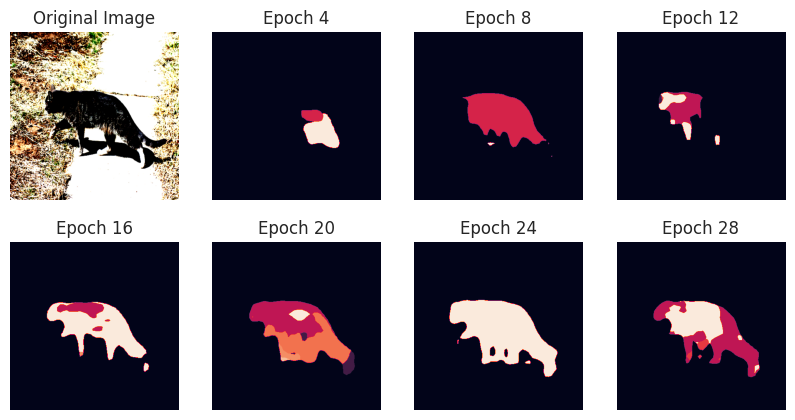

We used the fact that we save our model weights inbetween epochs to visually inspect how our model performs on or validation set. The plot above is from the Fcn Resnet model.

This cat is the first image of our validation set. We can see that quite a lot changes from epoch to epoch, especially because we are plotting the first 28 epochs, which saw the biggest loss decrease on our plots earlier.

Inspection of further epochs (30-60) do not show a visual increase in the segmentation map. Epoch 24's map is about as accurate as we were able to get this setup.

----

We learned a lot working with the previous setup, but were not yet happy with its final performance. Both previous models still lacked the clear visual segmenation we were looking for.

Therefore, we changed our approach, focusing back on the Keras framework to experiment not with inter-model flexibility, but different models.

To do so, we again load and pre-process our data. Then we list several models we tested. The last model is the one that showed the most promise.

In [87]:
def load_and_preprocess_seg_data(image_size=128):
    """Loads and preprocesses segmentation data.

    Args:
      image_size: The desired size for resizing images and segmentations.

    Returns:
      A tuple containing:
          images: A list of preprocessed images (normalized to 0-1).
          segmentations: A list of one-hot encoded segmentation masks.
    """

    train_df = pd.read_csv(path_to_train + 'train_set.csv', index_col="Id")
    labels = train_df.columns

    # Load images and segmentations using pandas vectorized access
    train_df["img"] = [np.load(path_to_train + 'img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
    train_df["seg"] = [np.load(path_to_train + 'seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]

    images = []
    segmentations = []

    for row in range(len(train_df)):
        images.append(cv2.resize(train_df.at[row, "img"], (image_size,image_size))/ 255.)
        segmentations.append(cv2.resize(train_df.at[row, "seg"], (image_size,image_size)))

    # One-hot encode segmentations
    segmentations = tf.keras.utils.to_categorical(segmentations, num_classes=21)

    return images, segmentations

In [88]:
Y = train_df["seg"]
distribution = np.mean([[np.sum(Y_ == i) / Y_.size for i in range(len(labels) + 1)] for Y_ in Y], axis=0)
print("Distribution:")
print(f"background:{distribution[0]*100}%")
for i in range(len(distribution)-1):
    print(f"{labels[i]}: {distribution[i+1]*100}%")

Distribution:
background:77.74704888071216%
aeroplane: 0.7051912139390122%
bicycle: 0.3034046130540534%
bird: 0.9781050583857026%
boat: 0.7920222121661963%
bottle: 0.801371700061968%
bus: 1.4444057783372053%
car: 1.299203192837253%
cat: 1.6639155300546395%
chair: 0.8264122763258911%
cow: 0.6782009244183502%
diningtable: 1.3744445666126768%
dog: 0.7408055878516008%
horse: 0.8338953677311486%
motorbike: 1.079509937004467%
person: 4.101362114757774%
pottedplant: 0.539385590505006%
sheep: 0.9157332163106574%
sofa: 0.958005931515607%
train: 1.2118249521815818%
tvmonitor: 1.0057513552370658%


Below is an overview of several of the models we have constructed and validated.
----

In [89]:
from tensorflow.keras import layers

In [90]:
def build_segnet_model(input_shape=(128, 128, 3)):
    """Builds a SegNet model for image segmentation.

    Args:
      input_shape: The shape of the input image (height, width, channels).

    Returns:
      A compiled SegNet model.
    """

    inputs = layers.Input(shape=input_shape)

    # Encoder block (with downsampling)
    def encoder_block(x, filters):
        x = layers.Conv2D(filters, (3, 3), padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters, (3, 3), padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.MaxPooling2D((2, 2), padding='same')(x)
        return x

    # Decoder block (with upsampling)
    def decoder_block(x, filters):
        x = layers.Conv2D(filters, (3, 3), padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.Conv2D(filters, (3, 3), padding='same')(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)
        x = layers.UpSampling2D((2, 2))(x)
        return x

    # Encoder
    encoded = encoder_block(inputs, 64)
    encoded = encoder_block(encoded, 128)
    encoded = encoder_block(encoded, 256)
    encoded = encoder_block(encoded, 512)

    # Decoder
    decoded = decoder_block(encoded, 512)
    decoded = decoder_block(decoded, 256)
    decoded = decoder_block(decoded, 128)
    decoded = decoder_block(decoded, 64)

    # Output layer with softmax activation for segmentation mask
    outputs = layers.Conv2D(21, (3, 3), padding='same', activation="softmax")(decoded)

    # Create the model
    segnet_model = tf.keras.Model(inputs, outputs, name="SegNet")

    return segnet_model

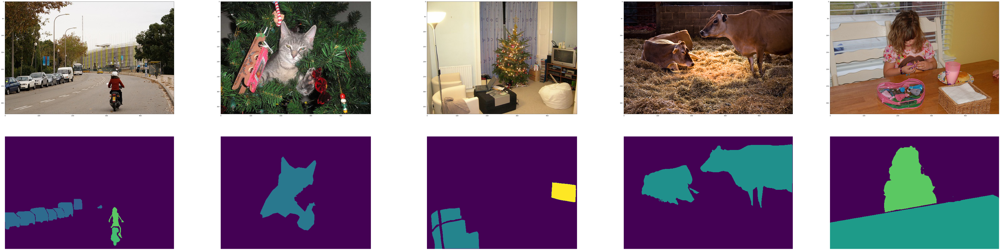

In [91]:
fig, axs = plt.subplots(2, 5, figsize=(6 * 20, 15 * 2))
for i, label in enumerate(labels[6:11]):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")

plt.show()

In [92]:
!pip install segmentation-models

In [93]:
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

In [94]:
import segmentation_models as sm
IoU_score = sm.metrics.IOUScore(threshold=0.5)
dice_score = sm.metrics.FScore(threshold=0.5)

In [95]:
from tensorflow.keras import losses, metrics
from sklearn.model_selection import train_test_split
import cv2

train_X_seg, train_y_seg = load_and_preprocess_seg_data()
train_seg_X, val_seg_X, train_seg_y, val_seg_y = train_test_split(train_X_seg, train_y_seg, test_size=0.05)


if False:
    segnet_model = build_segnet_model(input_shape=(128,128,3))

    # Compile the model
    segnet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=sm.losses.categorical_focal_dice_loss,
                      metrics=['accuracy', dice_score, IoU_score,])

    model_history = segnet_model.fit(np.array(train_seg_X), np.array(train_seg_y), epochs=30, batch_size = 5,
                                     validation_data=(np.array(val_seg_X), np.array(val_seg_y)))

In [96]:
if False:

    fig, axs = plt.subplots(3, 3, figsize=(3 * 3, 3 * 3))
    for index in range(3):
        axs[0, index].imshow(val_seg_X[index], vmin=0, vmax=255)
        axs[1, index].imshow(np.argmax(val_seg_y[index],-1), vmin=0, vmax=20)
        axs[2, index].imshow(np.argmax(segnet_model.predict(np.expand_dims(val_seg_X[index], axis=0))[0],-1), vmin=0, vmax=20)
        axs[0, index].axis("off")
        axs[1, index].axis("off")
        axs[2, index].axis("off")
        axs[0, index].set_title("Image")
        axs[1, index].set_title("Segment Mask")
        axs[2, index].set_title("Prediction")
    plt.show()

In [97]:
import tensorflow.keras.layers as layers

def downsample_block(x, n_filters):
    x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    f = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    p = layers.MaxPool2D(2)(f)
    return f, p

def upsample_block(x, conv_features, n_filters):
    # Upsample
    x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)

    # Concatenate
    x = layers.concatenate([x, conv_features])

    # Conv2D twice with ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    return x

def build_unet_model(input_shape=(128,128,3)):
    inputs = layers.Input(shape=input_shape)

    # Encoder
    # Downsample
    f1, p1 = downsample_block(inputs, 32)
    f2, p2 = downsample_block(p1, 64)
    f3, p3 = downsample_block(p2, 128)
    f4, p4 = downsample_block(p3, 256)

    # Bottleneck: Conv2D twice with ReLU activation
    bottleneck = layers.Conv2D(512, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(p4)
    bottleneck = layers.Conv2D(512, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(bottleneck)

    # Decoder
    # Upsample
    u6 = upsample_block(bottleneck, f4, 256)
    u7 = upsample_block(u6, f3, 128)
    u8 = upsample_block(u7, f2, 64)
    u9 = upsample_block(u8, f1, 32)

    outputs = layers.Conv2D(21, 1, padding="same", activation = "softmax")(u9)

    return tf.keras.Model(inputs, outputs, name="U-Net")

In [98]:
if False:
    train_X_seg, train_y_seg = load_and_preprocess_seg_data()
    train_seg_X, val_seg_X, train_seg_y, val_seg_y = train_test_split(train_X_seg, train_y_seg, test_size=0.05)

    unet_model = build_unet_model()

    unet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=sm.losses.categorical_focal_dice_loss,
                      metrics=['accuracy', dice_score, IoU_score,])

    model_history = unet_model.fit(np.array(train_seg_X), np.array(train_seg_y), epochs=1, batch_size = 5,
                                     validation_data=(np.array(val_seg_X), np.array(val_seg_y)))

In [99]:
if False:

    fig, axs = plt.subplots(3, 3, figsize=(3 * 3, 3 * 3))
    for index in range(3):
        axs[0, index].imshow(val_seg_X[index], vmin=0, vmax=255)
        axs[1, index].imshow(np.argmax(val_seg_y[index],-1), vmin=0, vmax=20)
        axs[2, index].imshow(np.argmax(unet_model.predict(np.expand_dims(val_seg_X[index], axis=0))[0],-1), vmin=0, vmax=20)
        axs[0, index].axis("off")
        axs[1, index].axis("off")
        axs[2, index].axis("off")
        axs[0, index].set_title("Image")
        axs[1, index].set_title("Segment Mask")
        axs[2, index].set_title("Prediction")
    plt.show()


## Unet transfer learning

#### UNet with VGG16 encoder

In [100]:
from tensorflow.keras.applications import VGG16

def build_unet_vgg_model(input_shape=(128, 128, 3), num_classes=21):
    # Load VGG16 model pretrained on ImageNet without fully connected layers
    vgg16 = VGG16(include_top=False, weights='imagenet', input_shape=input_shape)

    # Encoder
    # Block 1
    f1, p1 = downsample_block(vgg16.input, 64)
    # Block 2
    f2, p2 = downsample_block(p1, 128)
    # Block 3
    f3, p3 = downsample_block(p2, 256)
    # Block 4
    f4, p4 = downsample_block(p3, 512)

    # Bottleneck
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(p4)
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(bottleneck)

    # Decoder
    # Upsample
    u6 = upsample_block(bottleneck, f4, 512)
    u7 = upsample_block(u6, f3, 256)
    u8 = upsample_block(u7, f2, 128)
    u9 = upsample_block(u8, f1, 64)

    outputs = layers.Conv2D(num_classes, 1, padding="same", activation="softmax")(u9)

    model = tf.keras.Model(inputs=vgg16.input, outputs=outputs, name="VGG16_U-Net")

    return model

In [101]:
if False:
    train_X_seg, train_y_seg = load_and_preprocess_seg_data()
    train_seg_X, val_seg_X, train_seg_y, val_seg_y = train_test_split(train_X_seg, train_y_seg, test_size=0.05)

    unet_vgg_model = build_unet_vgg_model()

    unet_vgg_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=sm.losses.categorical_focal_dice_loss,
                      metrics=['accuracy', dice_score, IoU_score,])

    model_history = unet_vgg_model.fit(np.array(train_seg_X), np.array(train_seg_y), epochs=100, batch_size = 5,
                                     validation_data=(np.array(val_seg_X), np.array(val_seg_y)))

In [102]:
# unet_vgg_model.save_weights('unet_vgg_weights.h5')

#### UNet with EfficientNet encoder

In [103]:
from efficientnet.tfkeras import EfficientNetB0  # Import EfficientNetB0 from the efficientnet package

def build_unet_efficientnet_model(input_shape=(128, 128, 3), num_classes=21):
    # Load EfficientNetB0 model pretrained on ImageNet
    efficientnet = EfficientNetB0(include_top=False, input_shape=input_shape, weights='imagenet')

    # Encoder
    # The block outputs are stored for skip connections
    block1, p1 = downsample_block(efficientnet.input, 32)
    block2, p2 = downsample_block(p1, 64)
    block3, p3 = downsample_block(p2, 128)
    block4, p4 = downsample_block(p3, 256)
    block5, p5 = downsample_block(p4, 512)

    # Bottleneck
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(p5)
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(bottleneck)

    # Decoder
    # Upsample
    u6 = upsample_block(bottleneck, block5, 512)
    u7 = upsample_block(u6, block4, 256)
    u8 = upsample_block(u7, block3, 128)
    u9 = upsample_block(u8, block2, 64)
    u10 = upsample_block(u9, block1, 32)

    # Output layer
    outputs = layers.Conv2D(num_classes, 1, padding="same", activation="softmax")(u10)

    # Define the model
    model = tf.keras.Model(inputs=efficientnet.input, outputs=outputs, name="EfficientNet_U-Net")

    return model

In [104]:
if False:
    train_X_seg, train_y_seg = load_and_preprocess_seg_data()
    train_seg_X, val_seg_X, train_seg_y, val_seg_y = train_test_split(train_X_seg, train_y_seg, test_size=0.05)

    unet_efficientnet_model = build_unet_efficientnet_model()

    unet_efficientnet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=sm.losses.categorical_focal_dice_loss,
                      metrics=['accuracy', dice_score, IoU_score,])

    model_history = unet_efficientnet_model.fit(np.array(train_seg_X), np.array(train_seg_y), epochs=100, batch_size = 5,
                                     validation_data=(np.array(val_seg_X), np.array(val_seg_y)))

In [105]:
# unet_efficientnet_model.save_weights('unet_efficientnet_weights.h5')

#### UNet with ResNet50 encoder

In [106]:
from tensorflow.keras.applications import ResNet50

In [107]:
def build_unet_resnet_model(input_shape=(128, 128, 3), num_classes=21):
    # Load ResNet model pretrained on ImageNet
    resnet = ResNet50(
        include_top=False,
        weights='imagenet',
        input_shape=input_shape,
        classes=num_classes,
        classifier_activation='softmax',
    )

    # Encoder
    # The block outputs are stored for skip connections
    block1, p1 = downsample_block(resnet.input, 32)
    block2, p2 = downsample_block(p1, 64)
    block3, p3 = downsample_block(p2, 128)
    block4, p4 = downsample_block(p3, 256)
    block5, p5 = downsample_block(p4, 512)

    # Bottleneck
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(p5)
    bottleneck = layers.Conv2D(1024, 3, padding="same", activation="relu", kernel_initializer="he_normal")(bottleneck)

    # Decoder
    # Upsample
    u6 = upsample_block(bottleneck, block5, 512)
    u7 = upsample_block(u6, block4, 256)
    u8 = upsample_block(u7, block3, 128)
    u9 = upsample_block(u8, block2, 64)
    u10 = upsample_block(u9, block1, 32)

    # Output layer
    outputs = layers.Conv2D(num_classes, 1, padding="same", activation="softmax")(u10)

    # Define the model
    model = tf.keras.Model(inputs=resnet.input, outputs=outputs, name="ResNet_U-Net")

    return model

In [108]:
if False:
    train_X_seg, train_y_seg = load_and_preprocess_seg_data()
    train_seg_X, val_seg_X, train_seg_y, val_seg_y = train_test_split(train_X_seg, train_y_seg, test_size=0.05)

    unet_resnet_model = build_unet_resnet_model()

    unet_resnet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                      loss=sm.losses.categorical_focal_dice_loss,
                      metrics=['accuracy', dice_score, IoU_score,])

    model_history = unet_resnet_model.fit(np.array(train_seg_X), np.array(train_seg_y), epochs=100, batch_size = 5,
                                     validation_data=(np.array(val_seg_X), np.array(val_seg_y)))

In [109]:
# unet_resnet_model.save_weights('unet_resnet_weights.h5')

### EfficientNet prediction plots

As mentioned above, the efficientNet implementation showed the most promise and will be used for the final upload.

In [110]:
# load efficientnet model weights
unet_efficientnet_model = build_unet_efficientnet_model()

unet_efficientnet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                    loss=sm.losses.categorical_focal_dice_loss,
                    metrics=['accuracy', dice_score, IoU_score,])

unet_efficientnet_model.load_weights(path_to_ext_dataset + 'unet_efficientnet_weights.h5')

16804768/16804768 [==============================] - 0s 0us/step


1/1 [==============================] - 0s 21ms/step


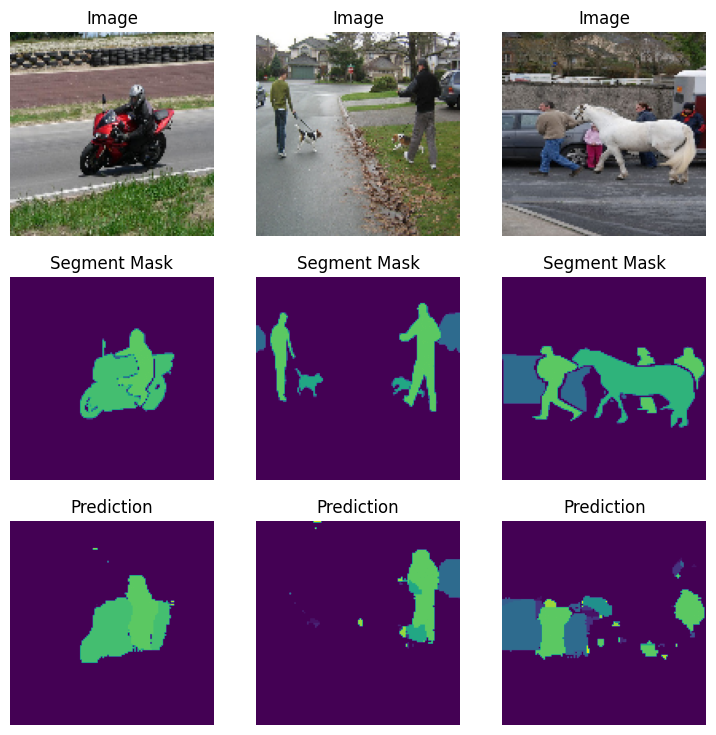

In [111]:
if True:

    fig, axs = plt.subplots(3, 3, figsize=(3 * 3, 3 * 3))
    for index in range(3):
        axs[0, index].imshow(val_seg_X[index], vmin=0, vmax=255)
        axs[1, index].imshow(np.argmax(val_seg_y[index],-1), vmin=0, vmax=20)
        axs[2, index].imshow(np.argmax(unet_efficientnet_model.predict(np.expand_dims(val_seg_X[index], axis=0))[0],-1), vmin=0, vmax=20)
        axs[0, index].axis("off")
        axs[1, index].axis("off")
        axs[2, index].axis("off")
        axs[0, index].set_title("Image")
        axs[1, index].set_title("Segment Mask")
        axs[2, index].set_title("Prediction")

    plt.savefig('efficientNet_predictions.jpg')
    plt.show()

We can now create the segmentation section of our submission file

In [112]:
test_df = test_df_submission.copy()
images_test = []
images_test_sizes = []

image_size = 128

# Get the images from test_df and preprocess them
for row in range(len(test_df)):
    images_test.append(cv2.resize(test_df.at[row, "img"], (image_size,image_size))/ 255.)
    images_test_sizes.append(test_df.at[row, "img"].shape)

In [118]:
# Predict the segmentations for the test images
segmentations_test = unet_efficientnet_model.predict(np.array(images_test))

24/24 [==============================] - 3s 57ms/step


In [119]:
# Reshape the segmentations to the original image size
segmentations_test_resized = []
for i in range(len(segmentations_test)):
    segmentations_test_resized.append(cv2.resize(segmentations_test[i], (images_test_sizes[i][1], images_test_sizes[i][0])))

# do different binarization to argmax
segmentations_test_resized_argmax = []
for i in range(len(segmentations_test_resized)):
    segmentations_test_resized_argmax.append(np.argmax(segmentations_test_resized[i], axis=-1))

# make the segmentations binary one-hot encoding
segmentations_test_resized_binary = []
for i in range(len(segmentations_test_resized)):
    segmentations_test_resized_binary.append(tf.keras.utils.to_categorical(segmentations_test_resized_argmax[i], num_classes=21))

In [120]:
print(segmentations_test_resized_binary[0].shape)

(375, 500, 21)


In [121]:
test_df_submission = test_df_submission.drop(columns=["seg"])
test_df_submission["seg"] = segmentations_test_resized_binary

In [122]:
# generate_submission(test_df_submission)     # TODO remove

# 4. Adversarial attack
For this section, our goal was to fool the classification CNN, using an *adversarial attack*.

More specifically, the goal was to build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

## 4.1 ResNet inverse training <a id='resnet'></a>

Before the fooling can begin, we first need to define the model we will be challenging. This will be InceptionResNetV2.

As we are only interested in the two classes of which we want to switch the prediction, we start by selecting the subset "bus" and "car" from our training set.

In [123]:
train_df = pd.read_csv(path_to_train+'train_set.csv', index_col="Id")
train_df["img"] = [np.load(path_to_train+'img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load(path_to_train+'seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]

class1 = 'bus'
class2 = 'car'

filtered_train_df = train_df[((train_df[class1] == 1) & (train_df[class2] == 0)) | ((train_df[class1] == 0) & (train_df[class2] == 1))]

These images are resized and normalized, as we would do with a normal training process.

In [124]:
image_size = 224

for i in filtered_train_df.index:
    filtered_train_df.at[i, 'img'] = cv.resize(filtered_train_df.at[i, 'img'],(image_size,image_size))/255.0

images_train = [row.img for row in filtered_train_df.itertuples()]
labels_train =[0 if getattr(row, class1, None) == 1 else 1 for row in filtered_train_df.itertuples()]

from sklearn.model_selection import train_test_split

train_X, val_X, train_y, val_y = train_test_split(images_train, labels_train, test_size=0.10)

print("Number of training examples:", len(train_X))
print("Number of validation examples:", len(val_X))

Number of training examples: 76
Number of validation examples: 9


We import the ResNet model and fit it to **inverted data**. This means that we learn the model to predict a bus as a car and vice versa. This makes our eventiual goal to make the fooled model to predict our original labels.

In [125]:
from keras.applications import InceptionResNetV2
from keras.losses import BinaryCrossentropy

resNet = InceptionResNetV2(
    include_top=False,
    weights='imagenet',
    input_shape=(image_size,image_size, 3),
    pooling='avg',
)

219055592/219055592 [==============================] - 1s 0us/step


In [126]:
# Freeze the weights of all layers
resNet.trainable = False

model = tf.keras.models.Sequential([
    resNet,
    Dense(1, activation='sigmoid')
])

train_y_inverted = np.where(np.array(train_y) == 0, 1, 0)
val_y_inverted = np.where(np.array(val_y) == 0, 1, 0)

In [127]:
%timeit
# Reference time: 20s with A100 TPU, 83.5GB RAM

# # training
model.compile(optimizer=Adam(learning_rate=0.001), loss=BinaryCrossentropy(from_logits=False), metrics=['accuracy'])
# model.fit(np.array(train_X), train_y_inverted, batch_size=16, epochs=20, validation_data=(np.array(val_X), val_y_inverted), verbose=1)
# model.save_weights(path_to_ext_dataset + "resnet_weights.h5")

Epoch 1/20
5/5 [==============================] - 17s 1s/step - loss: 0.7210 - accuracy: 0.5526 - val_loss: 0.9672 - val_accuracy: 0.3333
Epoch 2/20
5/5 [==============================] - 0s 48ms/step - loss: 0.4854 - accuracy: 0.7237 - val_loss: 0.6261 - val_accuracy: 0.7778
Epoch 3/20
5/5 [==============================] - 0s 46ms/step - loss: 0.3228 - accuracy: 0.8947 - val_loss: 0.3557 - val_accuracy: 0.8889
Epoch 4/20
5/5 [==============================] - 0s 46ms/step - loss: 0.2463 - accuracy: 0.9211 - val_loss: 0.3033 - val_accuracy: 0.8889
Epoch 5/20
5/5 [==============================] - 0s 46ms/step - loss: 0.1932 - accuracy: 0.9342 - val_loss: 0.3011 - val_accuracy: 0.8889
Epoch 6/20
5/5 [==============================] - 0s 45ms/step - loss: 0.1623 - accuracy: 0.9605 - val_loss: 0.2972 - val_accuracy: 0.8889
Epoch 7/20
5/5 [==============================] - 0s 45ms/step - loss: 0.1447 - accuracy: 0.9605 - val_loss: 0.2917 - val_accuracy: 0.8889
Epoch 8/20
5/5 [============

We can load the trained weights from a previous training run.

In [128]:
model.load_weights(path_to_ext_dataset + "resnet_weights.h5")

[loss, accuracy] = model.evaluate(np.array(val_X), np.array(val_y_inverted), batch_size=16, verbose=0)

print(f"Val Loss: {loss}")
print(f"Val Accuracy: {accuracy}")

Val Loss: 0.2873436510562897
Val Accuracy: 0.8888888955116272


## 4.2 The encoder network

Now that we have the model we have to fool, we can define our encoding network. This network is similar to SegNet, but without a stacked convolution layer. This encoding network transforms the input data into a format that effectively can mislead the original model above.

In [129]:
from keras.layers import Conv2D,BatchNormalization,Activation,MaxPooling2D,UpSampling2D,Input

def encoder(i,inp):
    res = Conv2D(i, (3, 3), padding='same')(inp)
    res = BatchNormalization()(res)
    res = Activation('relu')(res)
    return MaxPooling2D((2, 2), padding='same')(res)

def decoder(i,inp):
    res = Conv2D(i, (3, 3), padding='same')(inp)
    res = BatchNormalization()(res)
    res = Activation('relu')(res)
    return UpSampling2D((2, 2))(res)

input_shape = Input(shape=(image_size,image_size,3))

x = encoder(64,input_shape)
x = encoder(32,x)
x = encoder(16,x)

x = decoder(16,x)
x = decoder(32,x)
x = decoder(64,x)

# convert back to rgb image

x = Conv2D(3, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
adv_net = Activation('sigmoid')(x)

We define some additional functions to normalise and truncate the output of the model. We do this to avoid the image being changed too much. As humans, we should see a minimal change to the original image!

In [130]:
from tensorflow.math import multiply,reduce_max,abs,divide

def rescale_max_norm(x):
    return multiply(0.2, divide(x, reduce_max(abs(x))))

def rescale_max_norm_small(x):
    return multiply(0.07, divide(x, reduce_max(abs(x))))

def rescale_max_norm_large(x):
    return multiply(0.5, divide(x, reduce_max(abs(x))))

The above is wrapped in a Keras Lambda layer for easier use.

In [131]:
from keras.layers import Lambda
import tensorflow.keras.backend as bck

perturb_max = Lambda(rescale_max_norm, output_shape=(image_size,image_size,3), name='perturb_max')(adv_net)

def add_perturbation_to_img(x):
    perturbation,input_img = x
    return bck.clip(perturbation+input_img,0,1)

add_perturbation_max = Lambda(add_perturbation_to_img, output_shape=(image_size,image_size,3), name='add_perturb_max')([perturb_max,input_shape])

## 4.3 Fooling the model

We effectively place the Segnet and Lambda layers before the original Resnet model and evaluate.

We define several checkpoints below, where the model with the highest val accuracy is saved. As mentioned above, this is done based on the original labels. Because of our inverse training earlier, this means we are evaluating based on how "fooled" the model is.

In [132]:
model.trainable = False

max_norm_output = model(add_perturbation_max)

checkpoint_filepath_max = path_to_ext_dataset + 'max.weights.h5'
max_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath_max,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

checkpoint_filepath_max_small = path_to_ext_dataset + 'max_small.weights.h5'
max_small_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath_max_small,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

checkpoint_filepath_max_large = path_to_ext_dataset + 'max_large.weights.h5'
max_large_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath_max_large,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

In [133]:
adversary_model_max = Model(inputs=input_shape, outputs=max_norm_output)

adversary_model_max.compile(optimizer=Adam(learning_rate=0.001),loss=BinaryCrossentropy(from_logits=False), metrics = ['accuracy'])

max_history = adversary_model_max.fit(np.array(train_X), np.array(train_y), batch_size=16, epochs=250,
                        validation_data=(np.array(val_X),
                        np.array(val_y)),
                        verbose=1,
                        callbacks=[max_checkpoint_callback])

Epoch 1/250
5/5 [==============================] - 35s 3s/step - loss: 4.2417 - accuracy: 0.0132 - val_loss: 3.9239 - val_accuracy: 0.1111
Epoch 2/250
5/5 [==============================] - 0s 89ms/step - loss: 4.0315 - accuracy: 0.0132 - val_loss: 3.9252 - val_accuracy: 0.1111
Epoch 3/250
5/5 [==============================] - 0s 84ms/step - loss: 3.9118 - accuracy: 0.0132 - val_loss: 3.9368 - val_accuracy: 0.1111
Epoch 4/250
5/5 [==============================] - 0s 85ms/step - loss: 3.7707 - accuracy: 0.0132 - val_loss: 3.9361 - val_accuracy: 0.1111
Epoch 5/250
5/5 [==============================] - 0s 84ms/step - loss: 3.6208 - accuracy: 0.0263 - val_loss: 3.9268 - val_accuracy: 0.1111
Epoch 6/250
5/5 [==============================] - 0s 85ms/step - loss: 3.5443 - accuracy: 0.0132 - val_loss: 3.9224 - val_accuracy: 0.1111
Epoch 7/250
5/5 [==============================] - 0s 85ms/step - loss: 3.4141 - accuracy: 0.0395 - val_loss: 3.9208 - val_accuracy: 0.1111
Epoch 8/250
5/5 [====

In [134]:
adversary_model_max.load_weights(checkpoint_filepath_max)

After training we perform a quick sanity check, see how the model has been affected.

In [135]:
[loss_model, accuracy_model] = model.evaluate(np.array(val_X), np.array(val_y_inverted), batch_size=16, verbose=0)

print(f"Validation loss model: {loss_model}")
print(f"Validation accuracy: {accuracy_model}")

Validation loss model: 0.2873436510562897
Validation accuracy: 0.8888888955116272


In [136]:
[loss_max, acc_max] = adversary_model_max.evaluate(np.array(val_X), np.array(val_y), verbose=0)

print("Validation loss max norm:", loss_max)
print("Validation accuracy max norm:", acc_max)

Validation loss max norm: 3.4001874923706055
Validation accuracy max norm: 0.2222222238779068


The function below plots several images. This is to compare the image that was fooled, the original image and then the pertubation. The images are shown both for the train and validation set.

In [137]:
def plot_adversary(adversary_model, interm_image, interm_perturbation,version):

    predictions_train = np.round(adversary_model.predict(np.array(train_X), verbose=0)).reshape(len(train_X))
    predictions_val = np.round(adversary_model.predict(np.array(val_X), verbose=0)).reshape(len(val_X))

    fooled_images_train = np.array(train_X)[abs(predictions_train - train_y_inverted) == 1]
    fooled_labels_train = np.array(train_y)[abs(predictions_train - train_y_inverted) == 1]
    if len(fooled_images_train)>0:
        perturb_train = interm_perturbation.predict(fooled_images_train, verbose=0)

    fooled_images_val = np.array(val_X)[abs(predictions_val - val_y_inverted) == 1]
    fooled_labels_val = np.array(val_y)[abs(predictions_val - val_y_inverted) == 1]
    if len(fooled_images_val)>0:
        perturb_val = interm_perturbation.predict(fooled_images_val, verbose=0)

    if len(fooled_labels_train):
        fig, axs = plt.subplots(3, 1 , figsize=(4 * 2, 4 * 2))
        fig.suptitle('Training images'+version, fontsize=16)

        axs[0].imshow(interm_image.predict(np.expand_dims(fooled_images_train[0], axis=0), verbose=0)[0])
        if fooled_labels_train[0] == 1:
            axs[0].set_title("Model predicted: "+class1+", Actual: "+class2 , fontsize=10)
        else:
            axs[0].set_title("Model predicted: "+class2+", Actual: "+class1 , fontsize=10)
        axs[0].axis("off")
        axs[1].imshow(fooled_images_train[0])
        axs[1].axis("off")
        axs[2].imshow(perturb_train[0])
        axs[2].axis("off")
        plt.show()

    if len(fooled_images_val):
        fig, axs = plt.subplots(3, 1 , figsize=(4 * 2, 4 * 2))
        fig.suptitle('Validation images'+version, fontsize=16)

        axs[0].imshow(interm_image.predict(np.expand_dims(fooled_images_val[0], axis=0), verbose=0)[0])
        if fooled_labels_val[0] == 1:
            axs[0].set_title("Model predicted: "+class1+", Actual: "+class2 , fontsize=10)
        else:
            axs[0].set_title("Model predicted: "+class2+", Actual: "+class1 , fontsize=10)
        axs[0].axis("off")
        axs[1].imshow(fooled_images_val[0])
        axs[1].axis("off")
        axs[2].imshow(perturb_val[0])
        axs[2].axis("off")
        plt.show()

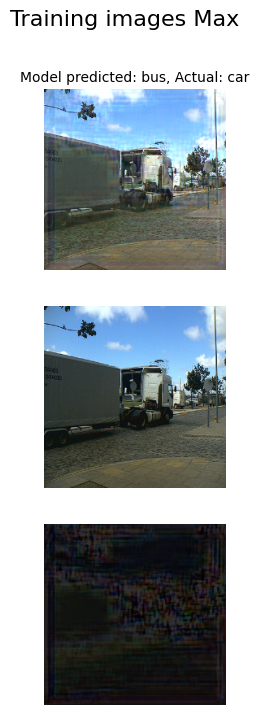

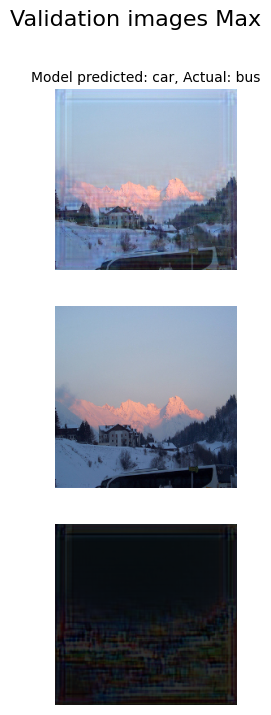

In [138]:
intermediate_pert_img_layer = Model(inputs=adversary_model_max.input,outputs=adversary_model_max.get_layer('add_perturb_max').output)
intermediate_perturbation_layer = Model(inputs=adversary_model_max.input,outputs=adversary_model_max.get_layer('perturb_max').output)

plot_adversary(adversary_model_max, intermediate_pert_img_layer, intermediate_perturbation_layer," Max")

We now repeat that process, but also with large and small normalization layers.

In [139]:
perturb_max_small = Lambda(rescale_max_norm_small, output_shape=(image_size,image_size,3), name='perturb_max_small')(adv_net)
perturb_max_large = Lambda(rescale_max_norm_large, output_shape=(image_size,image_size,3), name='perturb_max_large')(adv_net)

add_perturbation_max_small = Lambda(add_perturbation_to_img, output_shape=(image_size,image_size,3), name='add_perturb_max_small')([perturb_max_small,input_shape])
add_perturbation_max_large = Lambda(add_perturbation_to_img, output_shape=(image_size,image_size,3), name='add_perturb_max_large')([perturb_max_large,input_shape])


model.trainable = False

max_norm_output_small = model(add_perturbation_max_small)
max_norm_output_large = model(add_perturbation_max_large)

In [140]:
adversary_model_max_small = Model(inputs=input_shape, outputs=max_norm_output_small)
adversary_model_max_small.compile(optimizer=Adam(learning_rate=0.001),loss=BinaryCrossentropy(from_logits=False), metrics = ['accuracy'])

In [141]:
max_small_history = adversary_model_max_small.fit(np.array(train_X), np.array(train_y), batch_size=16, epochs=500,
                        validation_data=(np.array(val_X),
                        np.array(val_y)),
                        verbose=1,
                        callbacks=[max_small_checkpoint_callback])

Epoch 1/500
5/5 [==============================] - 25s 2s/step - loss: 3.2966 - accuracy: 0.0263 - val_loss: 3.8350 - val_accuracy: 0.1111
Epoch 2/500
5/5 [==============================] - 0s 95ms/step - loss: 3.0574 - accuracy: 0.0263 - val_loss: 3.8667 - val_accuracy: 0.1111
Epoch 3/500
5/5 [==============================] - 0s 87ms/step - loss: 2.8781 - accuracy: 0.0658 - val_loss: 3.8602 - val_accuracy: 0.1111
Epoch 4/500
5/5 [==============================] - 0s 90ms/step - loss: 2.7532 - accuracy: 0.0658 - val_loss: 3.8667 - val_accuracy: 0.1111
Epoch 5/500
5/5 [==============================] - 0s 86ms/step - loss: 2.6051 - accuracy: 0.0789 - val_loss: 3.9229 - val_accuracy: 0.1111
Epoch 6/500
5/5 [==============================] - 0s 86ms/step - loss: 2.5183 - accuracy: 0.1053 - val_loss: 3.8844 - val_accuracy: 0.1111
Epoch 7/500
5/5 [==============================] - 0s 86ms/step - loss: 2.3833 - accuracy: 0.1974 - val_loss: 3.8825 - val_accuracy: 0.1111
Epoch 8/500
5/5 [====

In [143]:
adversary_model_max_small.load_weights(path_to_ext_dataset + 'max_small.weights.h5')

In [144]:
[loss_max, acc_max] = adversary_model_max_small.evaluate(np.array(val_X), np.array(val_y), verbose=0)

print("Validation loss max norm:", loss_max)
print("Validation accuracy max norm:", acc_max)

Validation loss max norm: 3.834980010986328
Validation accuracy max norm: 0.1111111119389534


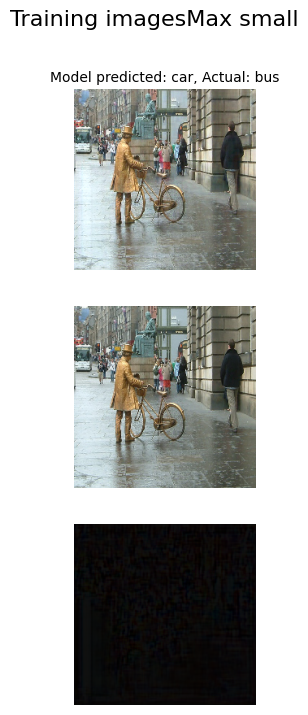

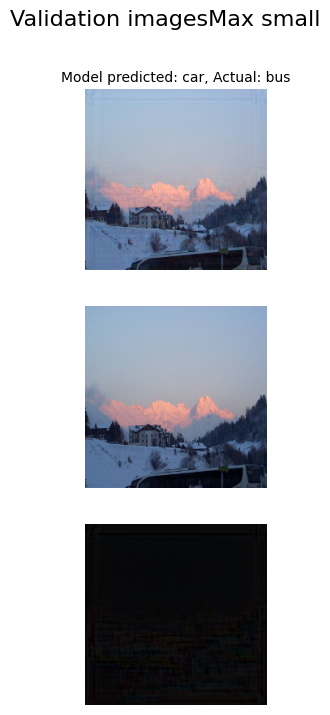

In [145]:
intermediate_pert_img_layer = Model(inputs=adversary_model_max_small.input,outputs=adversary_model_max_small.get_layer('add_perturb_max_small').output)
intermediate_perturbation_layer = Model(inputs=adversary_model_max_small.input,outputs=adversary_model_max_small.get_layer('perturb_max_small').output)

plot_adversary(adversary_model_max_small, intermediate_pert_img_layer, intermediate_perturbation_layer,"Max small")

In [146]:
adversary_model_max_large = Model(inputs=input_shape, outputs=max_norm_output_large)
adversary_model_max_large.compile(optimizer=Adam(learning_rate=0.001),loss=BinaryCrossentropy(from_logits=False), metrics = ['accuracy'])

In [148]:
max_large_history = adversary_model_max_large.fit(np.array(train_X), np.array(train_y), batch_size=16, epochs=500,
                        validation_data=(np.array(val_X),
                        np.array(val_y)),
                        verbose=1,
                        callbacks=[max_large_checkpoint_callback])

Epoch 1/500
5/5 [==============================] - 24s 2s/step - loss: 1.7613 - accuracy: 0.3289 - val_loss: 1.7850 - val_accuracy: 0.3333
Epoch 2/500
5/5 [==============================] - 0s 97ms/step - loss: 1.7581 - accuracy: 0.2895 - val_loss: 1.8176 - val_accuracy: 0.2222
Epoch 3/500
5/5 [==============================] - 0s 84ms/step - loss: 1.5669 - accuracy: 0.3289 - val_loss: 1.8977 - val_accuracy: 0.2222
Epoch 4/500
5/5 [==============================] - 0s 83ms/step - loss: 1.3527 - accuracy: 0.4079 - val_loss: 1.8966 - val_accuracy: 0.2222
Epoch 5/500
5/5 [==============================] - 0s 86ms/step - loss: 1.2217 - accuracy: 0.4342 - val_loss: 1.8823 - val_accuracy: 0.2222
Epoch 6/500
5/5 [==============================] - 0s 83ms/step - loss: 1.0827 - accuracy: 0.5263 - val_loss: 1.5481 - val_accuracy: 0.2222
Epoch 7/500
5/5 [==============================] - 0s 90ms/step - loss: 0.9665 - accuracy: 0.5263 - val_loss: 1.7427 - val_accuracy: 0.3333
Epoch 8/500
5/5 [====

In [149]:
adversary_model_max_large.load_weights(path_to_ext_dataset + 'max_large.weights.h5')

In [150]:
[loss_max, acc_max] = adversary_model_max_large.evaluate(np.array(val_X), np.array(val_y), verbose=0)

print("Validation loss max norm:", loss_max)
print("Validation accuracy max norm:", acc_max)

Validation loss max norm: 0.961238443851471
Validation accuracy max norm: 0.6666666865348816


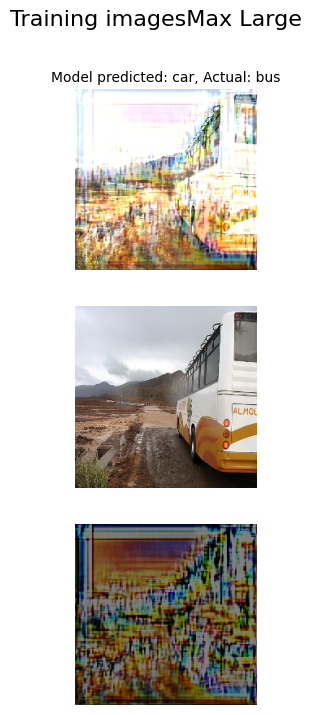

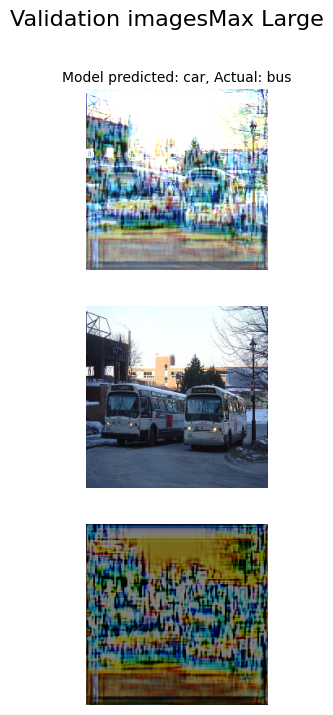

In [151]:
intermediate_pert_img_layer = tf.keras.Model(inputs=adversary_model_max_large.input,outputs=adversary_model_max_large.get_layer('add_perturb_max_large').output)
intermediate_perturbation_layer = tf.keras.Model(inputs=adversary_model_max_large.input,outputs=adversary_model_max_large.get_layer('perturb_max_large').output)

plot_adversary(adversary_model_max_large, intermediate_pert_img_layer, intermediate_perturbation_layer, "Max Large")

## 4.4 Adversarial attack conclusion

In conclusion, we believe the technique's effectiveness is limited and does not generalize well. However, that assessment is based on the relatively little data we have due to the extensive filtering required by the approach.

The method shows better results for classes that are more similar to each other, such as motorbikes, bicycles, and cars, but this might also be influenced by environmental factors, such as similar backgrounds in the photos.

In a real-world scenario, it could potentially be used to hack self-driving cars to always give priority to certain vehicles by making them think they are buses, for instance. However, it is unlikely that one would have easy access to the model for such manipulation, especially since it is not a white-box model.

Overall, the attack is moderately successful, and our photos remain more or less recognizable to us depending on the scale of perturbation. This does not render the original CNN unreliable, but its reliability would depend on the specific use case.

To enhance robustness, we could add adversarial training, where the adversarial model is retrained after each training step. Alternatively, we could look into  additional preprocessing detect and remove perturbations before feeding the data into the model.

[Return to top](#1-overview)